<a href="https://colab.research.google.com/github/anky19698/Cricket_Analytics/blob/main/Video_Keypoint_Detection_Mediapipe_Test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install mediapipe

In [ ]:
pip install ultralytics

In [22]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


# Image Dataset

In [118]:
import os
path = "/content/drive/MyDrive/getty/"
folders = os.listdir(path)
print(folders)

['drive', 'cutshot', 'sweep', 'pullshot']


In [119]:
import cv2
print(dir(cv2))
images  = []
labels  = []

# Define your image dimensions
target_height, target_width = 400, 400

for folder in folders:
  if 'mp4' in folder:
    continue
  names = os.listdir(path + folder)
  print(folder)
  i = 0
  for name in names:
    image = cv2.imread(path + folder + '/' + name)
    # Resize image while maintaining aspect ratio
    height, width, _ = image.shape
    aspect_ratio = width / height
    if aspect_ratio > 1:  # landscape orientation
        new_width = target_width
        new_height = int(new_width / aspect_ratio)
    else:  # portrait or square orientation
        new_height = target_height
        new_width = int(new_height * aspect_ratio)

    # Resize image to target dimensions
    resized_image = cv2.resize(image, (new_width, new_height))

    # Create padding to achieve target dimensions
    top_pad = (target_height - new_height) // 2
    bottom_pad = target_height - new_height - top_pad
    left_pad = (target_width - new_width) // 2
    right_pad = target_width - new_width - left_pad
    padded_image = cv2.copyMakeBorder(resized_image, top_pad, bottom_pad, left_pad, right_pad, cv2.BORDER_CONSTANT, value=(0, 0, 0))

    i+=1
#     if i>25:
#         break


    images.append(padded_image)
    labels.append(folder)


['ACCESS_FAST', 'ACCESS_MASK', 'ACCESS_READ', 'ACCESS_RW', 'ACCESS_WRITE', 'ADAPTIVE_THRESH_GAUSSIAN_C', 'ADAPTIVE_THRESH_MEAN_C', 'AGAST_FEATURE_DETECTOR_AGAST_5_8', 'AGAST_FEATURE_DETECTOR_AGAST_7_12D', 'AGAST_FEATURE_DETECTOR_AGAST_7_12S', 'AGAST_FEATURE_DETECTOR_NONMAX_SUPPRESSION', 'AGAST_FEATURE_DETECTOR_OAST_9_16', 'AGAST_FEATURE_DETECTOR_THRESHOLD', 'AKAZE', 'AKAZE_DESCRIPTOR_KAZE', 'AKAZE_DESCRIPTOR_KAZE_UPRIGHT', 'AKAZE_DESCRIPTOR_MLDB', 'AKAZE_DESCRIPTOR_MLDB_UPRIGHT', 'AKAZE_create', 'AffineFeature', 'AffineFeature_create', 'AffineTransformer', 'AgastFeatureDetector', 'AgastFeatureDetector_AGAST_5_8', 'AgastFeatureDetector_AGAST_7_12d', 'AgastFeatureDetector_AGAST_7_12s', 'AgastFeatureDetector_NONMAX_SUPPRESSION', 'AgastFeatureDetector_OAST_9_16', 'AgastFeatureDetector_THRESHOLD', 'AgastFeatureDetector_create', 'Algorithm', 'AlignExposures', 'AlignMTB', 'AsyncArray', 'BFMatcher', 'BFMatcher_create', 'BORDER_CONSTANT', 'BORDER_DEFAULT', 'BORDER_ISOLATED', 'BORDER_REFLECT', '

# Video Frames Capture

In [11]:
# Open video file
video_path = '/content/drive/MyDrive/getty/cover_drive.mp4'
cap = cv2.VideoCapture(video_path)

# Check if video opened successfully
if not cap.isOpened():
    print("Error: Could not open video.")
    exit()

video_frames = []

# Read the first frame
ret, frame = cap.read()

i = 0
# Loop through video frames
while ret:
    # Detect hand landmarks
    # frame_with_landmarks = show_pose(frame)
    i+=1
    if i % 20 == 0:
      frame = cv2.resize(frame, (300,600))
      video_frames.append(frame)

    # Break the loop if 'q' is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

    # Read the next frame
    ret, frame = cap.read()

# Release video capture object
cap.release()

# Close all OpenCV windows
cv2.destroyAllWindows()

# Mediapipe alt code

In [120]:
mp_holistic = mp.solutions.holistic
mp_drawing = mp.solutions.drawing_utils #Draw utilities

In [121]:
def multiple_detection(image,model):
    image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB) #Color convertion
    image.flags.writeable = False
    results = model.process(image)
    image.flags.writeable = True
    image = cv2.cvtColor(image,cv2.COLOR_RGB2BGR)
    return image,results

def draw_landmarks(image, results):
    mp_drawing.draw_landmarks(image, results.face_landmarks, mp_holistic.FACEMESH_CONTOURS) # Draw face connections
    mp_drawing.draw_landmarks(image, results.pose_landmarks, mp_holistic.POSE_CONNECTIONS) # Draw pose connections
    mp_drawing.draw_landmarks(image, results.left_hand_landmarks, mp_holistic.HAND_CONNECTIONS) # Draw left hand connections
    mp_drawing.draw_landmarks(image, results.right_hand_landmarks, mp_holistic.HAND_CONNECTIONS) # Draw right hand connections

def draw_styled_landmarks(image, results):
    # Draw face connections
    mp_drawing.draw_landmarks(image, results.face_landmarks, mp_holistic.FACEMESH_CONTOURS,
                             mp_drawing.DrawingSpec(color=(80,110,10), thickness=1, circle_radius=1),
                             mp_drawing.DrawingSpec(color=(80,256,121), thickness=1, circle_radius=1)
                             )
    # Draw pose connections
    mp_drawing.draw_landmarks(image, results.pose_landmarks, mp_holistic.POSE_CONNECTIONS,
                             mp_drawing.DrawingSpec(color=(80,22,10), thickness=2, circle_radius=4),
                             mp_drawing.DrawingSpec(color=(80,44,121), thickness=2, circle_radius=2)
                             )
    # Draw left hand connections
    mp_drawing.draw_landmarks(image, results.left_hand_landmarks, mp_holistic.HAND_CONNECTIONS,
                             mp_drawing.DrawingSpec(color=(121,22,76), thickness=2, circle_radius=4),
                             mp_drawing.DrawingSpec(color=(121,44,250), thickness=2, circle_radius=2)
                             )
    # Draw right hand connections
    mp_drawing.draw_landmarks(image, results.right_hand_landmarks, mp_holistic.HAND_CONNECTIONS,
                             mp_drawing.DrawingSpec(color=(245,117,66), thickness=2, circle_radius=4),
                             mp_drawing.DrawingSpec(color=(245,66,230), thickness=2, circle_radius=2)
                             )



In [122]:
pose = np.array([[res.x, res.y, res.z, res.visibility] for res in results.pose_landmarks.landmark]).flatten() if results.pose_landmarks else np.zeros(132)
face = np.array([[res.x, res.y, res.z] for res in results.face_landmarks.landmark]).flatten() if results.face_landmarks else np.zeros(1404)
lh = np.array([[res.x, res.y, res.z] for res in results.left_hand_landmarks.landmark]).flatten() if results.left_hand_landmarks else np.zeros(21*3)
rh = np.array([[res.x, res.y, res.z] for res in results.right_hand_landmarks.landmark]).flatten() if results.right_hand_landmarks else np.zeros(21*3)

In [123]:
def extract_keypoints(results):
    pose = np.array([[res.x, res.y, res.z, res.visibility] for res in results.pose_landmarks.landmark]).flatten() if results.pose_landmarks else np.zeros(33*4)
    face = np.array([[res.x, res.y, res.z] for res in results.face_landmarks.landmark]).flatten() if results.face_landmarks else np.zeros(468*3)
    lh = np.array([[res.x, res.y, res.z] for res in results.left_hand_landmarks.landmark]).flatten() if results.left_hand_landmarks else np.zeros(21*3)
    rh = np.array([[res.x, res.y, res.z] for res in results.right_hand_landmarks.landmark]).flatten() if results.right_hand_landmarks else np.zeros(21*3)

    return np.concatenate([pose, face, lh, rh])

In [124]:
from google.colab.patches import cv2_imshow

new_keypoints = []
new_labels = []
# for frame in video_frames:
for i in range(len(images)):
  frame = images[i]
  with mp_holistic.Holistic(min_detection_confidence=0.6,min_tracking_confidence=0.6) as holistic:
    image,results = multiple_detection(frame,holistic)
    print(i+1)
    # Draw landmark
    draw_styled_landmarks(image,results)
    # cv2_imshow(image)
    if results:
      kp = extract_keypoints(results)
      new_keypoints.append(kp)
      new_labels.append(labels[i])

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


In [125]:
len(new_keypoints), len(new_labels)

(620, 620)

## CNN Model

In [36]:
# for normalization
from sklearn.preprocessing import StandardScaler
# define normalizer
scaler= StandardScaler()
# normalize keypoints
keypoints = scaler.fit_transform(new_keypoints)
# convert to an array
keypoints = np.array(keypoints)

# converting the target categories into numbers
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y=le.fit_transform(new_labels)

# for creating training and validation sets
from sklearn.model_selection import train_test_split
# split keypoints and labels in 80:20
x_tr, x_val, y_tr, y_val = train_test_split(keypoints, y, test_size=0.2, stratify=y,
                                        random_state=120)

# converting the keypoints and target value to tensor
import torch
x_tr = torch.Tensor(x_tr)
x_val = torch.Tensor(x_val)
y_tr = torch.Tensor(y_tr)
y_tr = y_tr.type(torch.long)
y_val = torch.Tensor(y_val)
y_val = y_val.type(torch.long)

# shape of training and validation set
(x_tr.shape, y_tr.shape), (x_val.shape, y_val.shape)

((torch.Size([496, 1662]), torch.Size([496])),
 (torch.Size([124, 1662]), torch.Size([124])))

In [54]:
# importing libraries for defining the architecture of model
from torch.autograd import Variable
from torch.optim import Adam
from torch.nn import Linear, ReLU, Sequential, Softmax, CrossEntropyLoss
# defining the model architecture

model = Sequential(
    Linear(1662, 831),
    ReLU(),
    Linear(831, 277),
    ReLU(),
    Linear(277, 128),
    ReLU(),
    Linear(128, 4),
    Softmax()
)

# define optimizer and loss function
optimizer = Adam(model.parameters(), lr=0.01)
criterion = CrossEntropyLoss()
# checking if GPU is available
if torch.cuda.is_available():
    model = model.cuda()
    criterion = criterion.cuda()

def train(epoch):
    model.train()
    tr_loss = 0
    # getting the training set
    x_train, y_train = Variable(x_tr), Variable(y_tr)
    # getting the validation set
    x_valid, y_valid = Variable(x_val), Variable(y_val)
    # converting the data into GPU format
    if torch.cuda.is_available():
        x_train = x_train.cuda()
        y_train = y_train.cuda()
        x_valid = x_valid.cuda()
        y_valid = y_valid.cuda()
    # clearing the Gradients of the model parameters
    optimizer.zero_grad()
    # prediction for training and validation set
    output_train = model(x_train)
    output_val = model(x_valid)
    # computing the training and validation loss
    loss_train = criterion(output_train, y_train)
    loss_val = criterion(output_val, y_valid)
    # computing the updated weights of all the model parameters
    loss_train.backward()
    optimizer.step()
    if epoch%10 == 0:
        # printing the validation loss
        print('Epoch : ',epoch+1, 't', 'loss :', loss_val.item())

In [55]:
# defining the number of epochs
n_epochs = 100
# training the model
for epoch in range(n_epochs):
    train(epoch)

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1518: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return self._call_impl(*args, **kwargs)


Epoch :  1 t loss : 1.3834024667739868
Epoch :  11 t loss : 1.3404425382614136
Epoch :  21 t loss : 1.3404425382614136
Epoch :  31 t loss : 1.3404425382614136
Epoch :  41 t loss : 1.3404425382614136
Epoch :  51 t loss : 1.3404425382614136
Epoch :  61 t loss : 1.3404425382614136
Epoch :  71 t loss : 1.3404425382614136
Epoch :  81 t loss : 1.3404425382614136
Epoch :  91 t loss : 1.3404425382614136


In [56]:
# to check the model performance
from sklearn.metrics import accuracy_score
# get validation accuracy
x, y = Variable(x_val), Variable(y_val)
if torch.cuda.is_available():
  x_val = x.cuda()
  y_val = y.cuda()
pred = model(x_val)
final_pred = np.argmax(pred.cpu().data.numpy(), axis=1)
accuracy_score(y_val.cpu(), final_pred)

0.4032258064516129

## LSTM Model

In [126]:
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split

from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y=le.fit_transform(new_labels)

# Assuming you have loaded your labeled image data and extracted keypoints
# X contains flattened keypoints for each image, y contains corresponding labels
# for normalization
from sklearn.preprocessing import StandardScaler
# define normalizer
scaler= StandardScaler()
# normalize keypoints
keypoints = scaler.fit_transform(new_keypoints)
# convert to an array
X = np.array(keypoints)
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Reshape data to fit LSTM input shape
X_train = np.reshape(X_train, (X_train.shape[0], 1, X_train.shape[1]))
X_test = np.reshape(X_test, (X_test.shape[0], 1, X_test.shape[1]))

# Define model architecture
model = tf.keras.Sequential([
    tf.keras.layers.LSTM(128, input_shape=(X_train.shape[1], X_train.shape[2])),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(4, activation='softmax') # num_classes is the number of classes (e.g., 4 for pull, sweep, drive, cut)
])

# Compile the model
model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train, epochs=200, batch_size=64, validation_data=(X_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}, Test Accuracy: {accuracy}')

Epoch 1/200
8/8 [==============================] - 4s 106ms/step - loss: 1.2859 - accuracy: 0.4093 - val_loss: 1.2946 - val_accuracy: 0.3710
Epoch 2/200
8/8 [==============================] - 0s 25ms/step - loss: 1.1770 - accuracy: 0.4980 - val_loss: 1.1570 - val_accuracy: 0.5726
Epoch 3/200
8/8 [==============================] - 0s 24ms/step - loss: 1.0724 - accuracy: 0.5746 - val_loss: 1.0870 - val_accuracy: 0.5726
Epoch 4/200
8/8 [==============================] - 0s 26ms/step - loss: 0.9812 - accuracy: 0.5907 - val_loss: 1.0261 - val_accuracy: 0.5968
Epoch 5/200
8/8 [==============================] - 0s 24ms/step - loss: 0.9169 - accuracy: 0.6210 - val_loss: 1.0076 - val_accuracy: 0.5887
Epoch 6/200
8/8 [==============================] - 0s 23ms/step - loss: 0.8800 - accuracy: 0.6512 - val_loss: 1.0217 - val_accuracy: 0.5645
Epoch 7/200
8/8 [==============================] - 0s 23ms/step - loss: 0.8517 - accuracy: 0.6492 - val_loss: 0.9811 - val_accuracy: 0.6210
Epoch 8/200
8/8 [==

In [127]:
import os
import cv2
import mediapipe as mp

new_images = []
path = '/content/drive/MyDrive/test_images/'
keypoints = []

i = 0

images  = []
labels  = []

# Define your image dimensions
target_height, target_width = 400, 400

names = os.listdir(path)
for name in names:
  image = cv2.imread(path + name)
  # Resize image while maintaining aspect ratio
  height, width, _ = image.shape
  aspect_ratio = width / height
  if aspect_ratio > 1:  # landscape orientation
      new_width = target_width
      new_height = int(new_width / aspect_ratio)
  else:  # portrait or square orientation
      new_height = target_height
      new_width = int(new_height * aspect_ratio)

  # Resize image to target dimensions
  resized_image = cv2.resize(image, (new_width, new_height))

  # Create padding to achieve target dimensions
  top_pad = (target_height - new_height) // 2
  bottom_pad = target_height - new_height - top_pad
  left_pad = (target_width - new_width) // 2
  right_pad = target_width - new_width - left_pad
  padded_image = cv2.copyMakeBorder(resized_image, top_pad, bottom_pad, left_pad, right_pad, cv2.BORDER_CONSTANT, value=(0, 0, 0))

  i+=1
  new_images.append(padded_image)


for i in range(len(new_images)):
  frame = new_images[i]
  with mp_holistic.Holistic(min_detection_confidence=0.6,min_tracking_confidence=0.6) as holistic:
    image,results = multiple_detection(frame,holistic)
    print(i+1)
    # Draw landmark
    draw_styled_landmarks(image,results)
    # cv2_imshow(image)
    if results:
      kp = extract_keypoints(results)
      new_keypoints.append(kp)
      # new_labels.append(labels[i])



1
2
3
4
5
6
7
8
9
10
11


In [128]:
print(new_keypoints[0].shape)

(1662,)


(1662,)
1/1 [==============================] - 0s 457ms/step


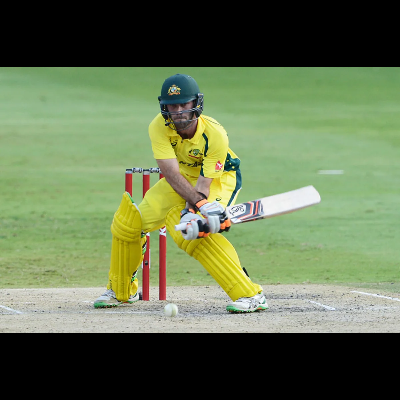

cutshot 0.5203264
(1662,)
1/1 [==============================] - 0s 24ms/step


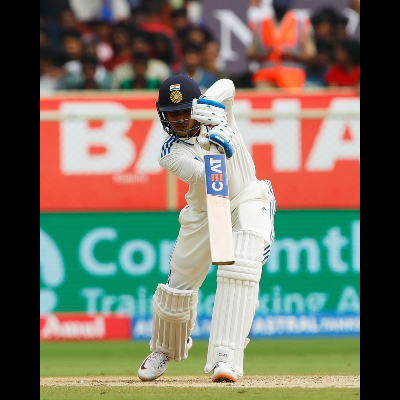

cutshot 0.5375851
(1662,)
1/1 [==============================] - 0s 24ms/step


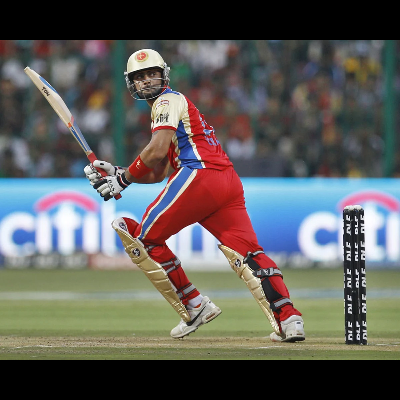

cutshot 0.7497842
(1662,)
1/1 [==============================] - 0s 33ms/step


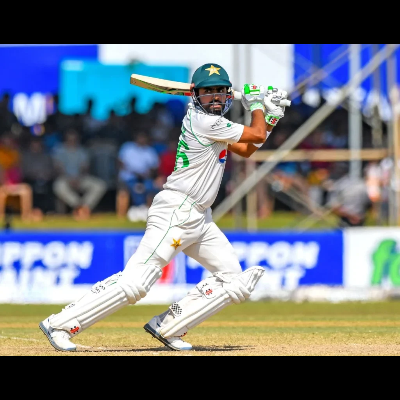

cutshot 0.5078881
(1662,)
1/1 [==============================] - 0s 24ms/step


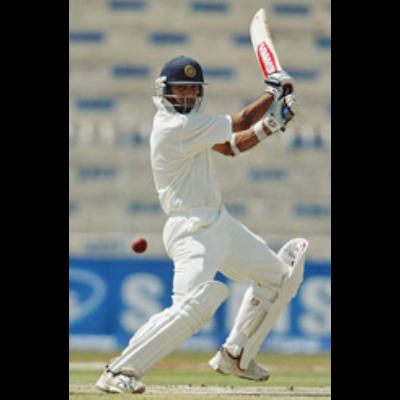

cutshot 0.5200503
(1662,)
1/1 [==============================] - 0s 91ms/step


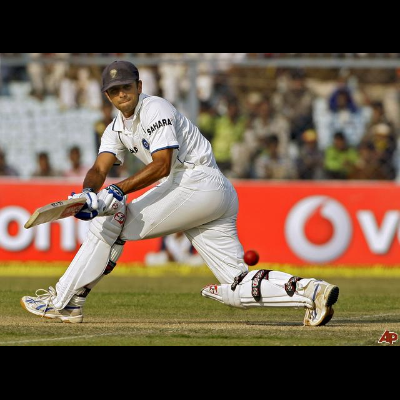

sweep 0.5691847
(1662,)
1/1 [==============================] - 0s 40ms/step


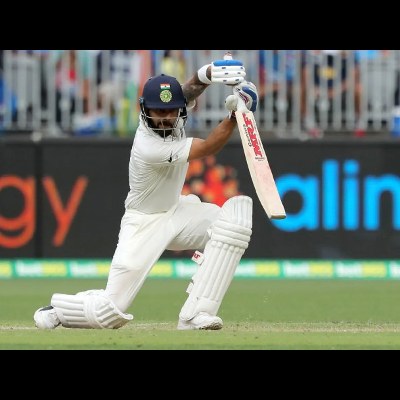

cutshot 0.5424864
(1662,)
1/1 [==============================] - 0s 41ms/step


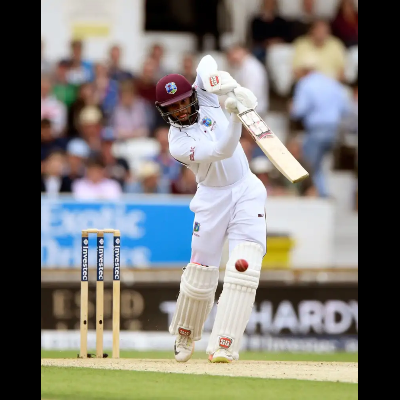

cutshot 0.5953232
(1662,)
1/1 [==============================] - 0s 65ms/step


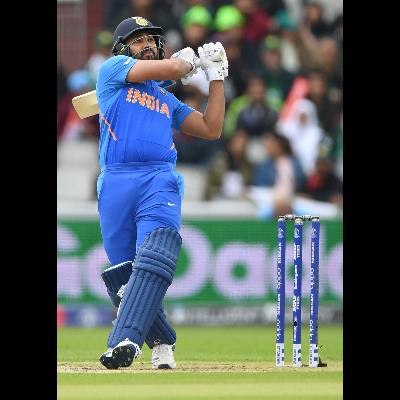

cutshot 0.5923095
(1662,)
1/1 [==============================] - 0s 125ms/step


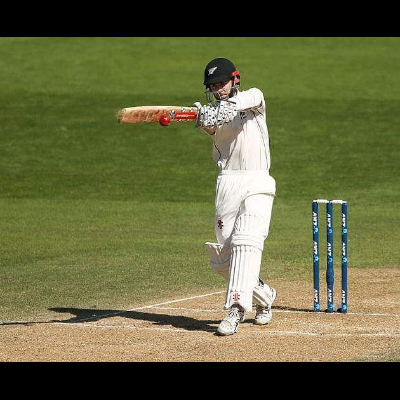

cutshot 0.887535
(1662,)
1/1 [==============================] - 0s 51ms/step


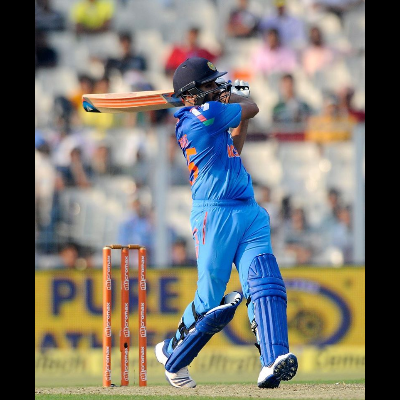

cutshot 0.54783374


In [129]:
# from sklearn.preprocessing import StandardScaler
from google.colab.patches import cv2_imshow

# # define normalizer
# scaler= StandardScaler()
# # normalize keypoints
# keypoints = scaler.fit_transform(new_keypoints)
# # convert to an array
# X = np.array(keypoints)

def predict_shot(image_keypoints):
    # Reshape the keypoints array to match the LSTM input shape
    image_keypoints = np.expand_dims(image_keypoints, axis=0)
    # Use the trained model to predict the shot class
    predicted_probs = model.predict(image_keypoints)
    predicted_class = np.argmax(predicted_probs)
    return predicted_class

# Example usage

for i in range(len(new_images)):
  print(new_keypoints[i].shape)
  image_keypoints = new_keypoints[i]
  image_keypoints = image_keypoints.reshape(1, 1, -1)
  predicted_probs = model.predict(image_keypoints)
  cv2_imshow(new_images[i])
  # print(predicted_probs)
  # Create dictionary to store class names and corresponding probabilities
  predicted_class_index = np.argmax(predicted_probs)
  # Define the class names
  class_names = ["cutshot", "drive", "pullshot", "sweep"]
  # Get the name of the predicted class
  predicted_class_name = class_names[predicted_class_index]
  # Return the name of the predicted class along with its confidence probability
  print(predicted_class_name, predicted_probs[0][predicted_class_index])


# Mediapipe

In [5]:
import cv2
import mediapipe as mp
import numpy as np
import tensorflow as tf
from google.colab.patches import cv2_imshow
from tqdm import tqdm, trange
import matplotlib.pyplot as plt
from ultralytics import YOLO


# Initialize MediaPipe Pose
mp_pose = mp.solutions.pose
pose = mp_pose.Pose(static_image_mode=False,
    min_detection_confidence=0.5,
    min_tracking_confidence=0.5)

def show_pose(im):
    results = pose.process(im)
    if results.pose_landmarks:
        new_width = 300
        new_height = 600
        im = cv2.resize(im,(300,600))
        mp_drawing = mp.solutions.drawing_utils
        image_with_landmarks = im.copy()
        mp_drawing.draw_landmarks(image_with_landmarks, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)
        image_with_landmarks = cv2.cvtColor(image_with_landmarks, cv2.COLOR_BGR2RGB)

        plt.figure(figsize = (10,10))
        plt.imshow(image_with_landmarks)
        plt.show()

    else:
        plt.figure(figsize = (10,10))
        plt.imshow(im)
        plt.show()

In [ ]:
len(video_frames)

55

In [ ]:
for frame in video_frames:
  show_pose(frame)

# Detectron2

In [ ]:
pip install 'git+https://github.com/facebookresearch/detectron2.git'

In [ ]:
from detectron2 import model_zoo

from detectron2.engine import DefaultPredictor

from detectron2.config import get_cfg

cfg = get_cfg()

cfg.MODEL.DEVICE = 'cpu'

cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_101_FPN_3x.yaml"))

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Keypoints/keypoint_rcnn_R_101_FPN_3x.yaml")

# cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_X_101_32x8d_FPN_3x.yaml"))

# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Keypoints/keypoint_rcnn_X_101_32x8d_FPN_3x.yaml")

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64

cfg.SOLVER.BASE_LR = 0.001

cfg.SOLVER.MAX_ITER = 2000

predictor = DefaultPredictor(cfg)

In [ ]:
# define function that extracts the keypoints for an image
keypoints   = []
lbl = []
def extract_keypoints(img):
  # make predictions
  outputs = predictor(img)
  # fetch keypoints
  kps = outputs['instances'].pred_keypoints
  # convert to numpy array
  kp = kps.cpu().numpy()
  # print(kp)
  # if keypoints detected
  if(len(kps)>0):
    # fetch keypoints of a person with maximum confidence score
    kp = kp[0]
    kp = np.delete(kp,2,1)
    # convert 2D array to 1D array
    kp = kp.flatten()
    # return keypoints
    return kp
    # keypoints.append(kp)

    # print(len(keypoints))

In [ ]:
for frame in video_frames:
  kp = extract_keypoints(frame)
  keypoints.append(kp)

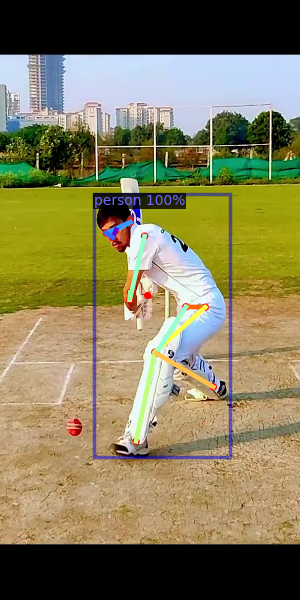

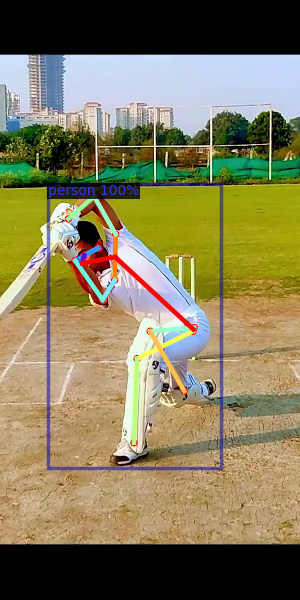

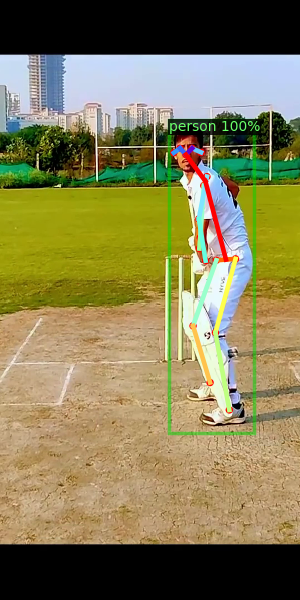

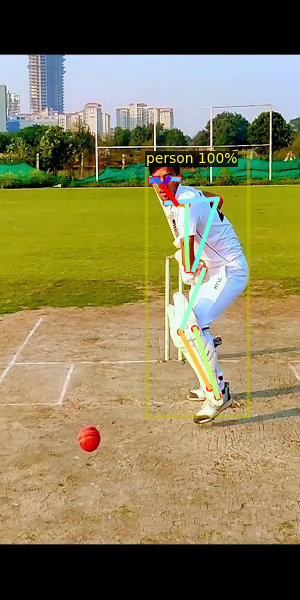

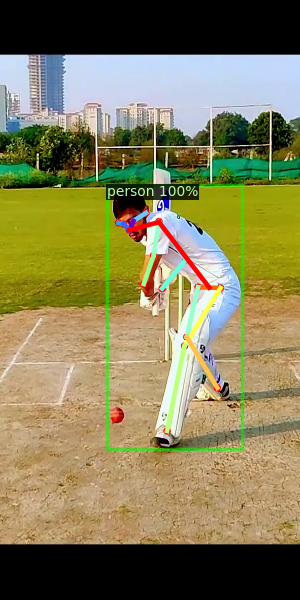

...

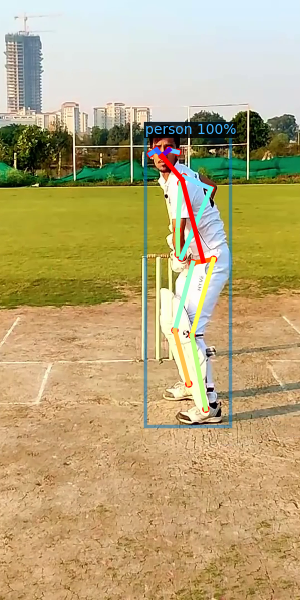

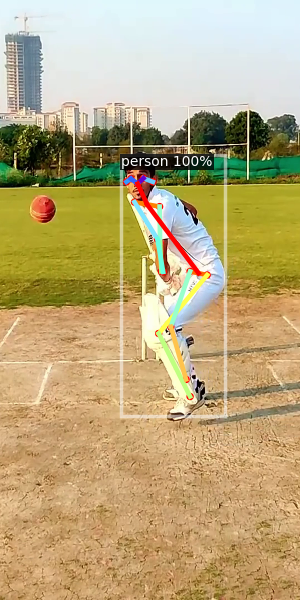

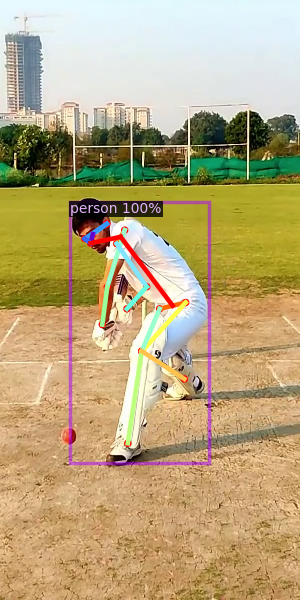

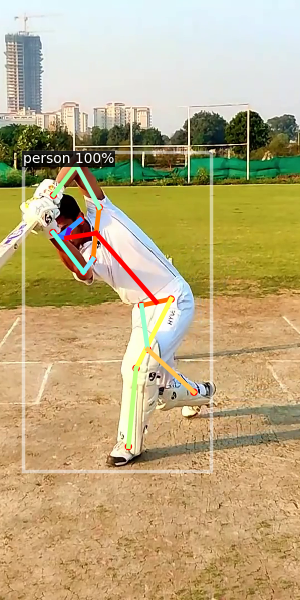

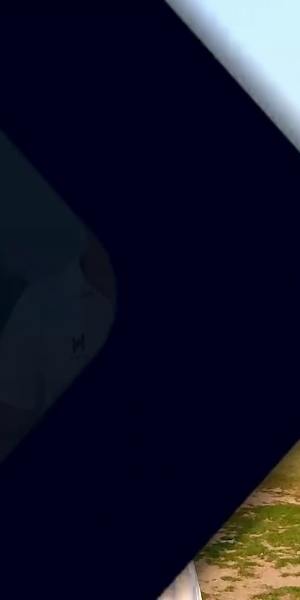

In [ ]:
import random

# for drawing predictions on images
from detectron2.utils.visualizer import Visualizer
# to obtain metadata
from detectron2.data import MetadataCatalog
# to display an image
# from google.colab.patches import cv2_imshow
# randomly select images
for img in video_frames:
    # make predictions
    outputs = predictor(img)
    # use `Visualizer` to draw the predictions on the image.
    v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1)
    # draw prediction on image
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    # display image
    cv2_imshow(v.get_image()[:, :, ::-1])